In [2]:
%qtconsole

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import imread

# Load data

In [4]:
cnn_dir = '/home/eric/data/mini/models/cnn/'
load_data = lambda fn: np.load(cnn_dir +  fn).item()

out = { 'test'  : { 'obj' : load_data('obj_vrd1/out/vrd_test.npy' ),
                    'rel' : load_data('rel_vrd2/out/vrd_test.npy' )  }
        'train' : { 'obj' : load_data('obj_vrd1/out/vrd_train.npy'),
                    'rel' : load_data('rel_vrd2/out/vrd_train.npy')  }  }

In [5]:
obj_train_acc = np.mean([int(o['prob'].argmax() == o['label'].argmax()) 
                         for o in O.values()])
obj_test_acc = np.mean([int(o['prob'].argmax() == o['label'].argmax()) 
                        for o in O.values()])
rel_train_acc = np.mean([int(o['prob'].argmax() == o['label'].argmax()) 
                         for o in O.values()])
rel_test_acc = np.mean([int(o['prob'].argmax() == o['label'].argmax()) 
                        for o in O['vg'].values()])

In [40]:
import sys; sys.path.append('../..')
from utils import loadmat

load = lambda fn: enumerate(loadmat('../../data/vrd/mat/' + fn + '.mat')[fn])
L = {'obj' : {i:r for i,r in load('objectListN')},
     'rel' : {i:r for i,r in load('predicate')}    }

In [ ]:
n_objs = 100
n_rels = 70

# Histograms

In [19]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode()

In [24]:
D = cnn['train']['obj']
uids, labels, probs = zip(*[(uid, d['label'], d['prob'])  for uid, d in D.items()])

labels = np.vstack(labels)
probs  = np.vstack(probs)

In [37]:
M = probs.argmax(axis=1)
#P = np.take(probs, M)
n, bins, _ = plt.hist(M, range=(0,100), bins=100)

labels = zip(*sorted(L['obj'].items()))[1]

layout = go.Layout(title='Top-1 Predicted Labels',
                   width=700, height=400, autosize=False)
data = [go.Bar(x=bins, y=n, text=labels)]

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='prob_hist')

In [30]:
labs = [L['obj'][b - 1] for b in bins if (b>0)]
top_preds = sorted(zip(n, labs), reverse=True)

top_preds[:10]

[(16898.0, u'person'),
 (5144.0, u'sky'),
 (1774.0, u'car'),
 (831.0, u'bus'),
 (237.0, u'chair'),
 (219.0, u'clock'),
 (123.0, u'traffic light'),
 (101.0, u'shirt'),
 (99.0, u'monitor'),
 (89.0, u'paper')]

# confusion 1: outer prod. w/ predictions

In [ ]:
N = probs / probs.sum(axis=0)
confusion = N.T.dot(N)
confusion = confusion * (np.ones_like(confusion) - np.eye(100))

In [9]:
labels = zip(*sorted(I['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=np.power(confusion, 0.25), 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

NameError: name 'confusion' is not defined

# confusion 2: GT vs. all predictions

In [8]:
# for each GT label, collect the distribution of predictions
# x: GT, y: predictions
confusion = np.zeros((637, 637))
G = D['label'].argmax(axis=1)

for g in G:
    confusion[g,:] += D['prob'][g,:]

In [9]:
# Normalize over each GT, so `\sum_P(pred | GT) = 1`
# z = np.tile(confusion.sum(axis=1), [637, 1])
confusion = confusion / confusion.sum(axis=1)[...,None]
confusion = np.nan_to_num(confusion)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in divide
  app.launch_new_instance()


In [13]:
confuse = np.power(confusion, .25)
labels = zip(*sorted(I['obj'].items()))[1]

layout = go.Layout(
    autosize=False,
    width=700,
    height=700,
)

data = [
    go.Heatmap(x=labels, 
               y=labels, 
               z=confuse, 
               colorscale='Greys')
]

fig = go.Figure(data=data, layout=layout)

iplot(fig, filename='confuse_matrix')

<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>
<br>

# scrap

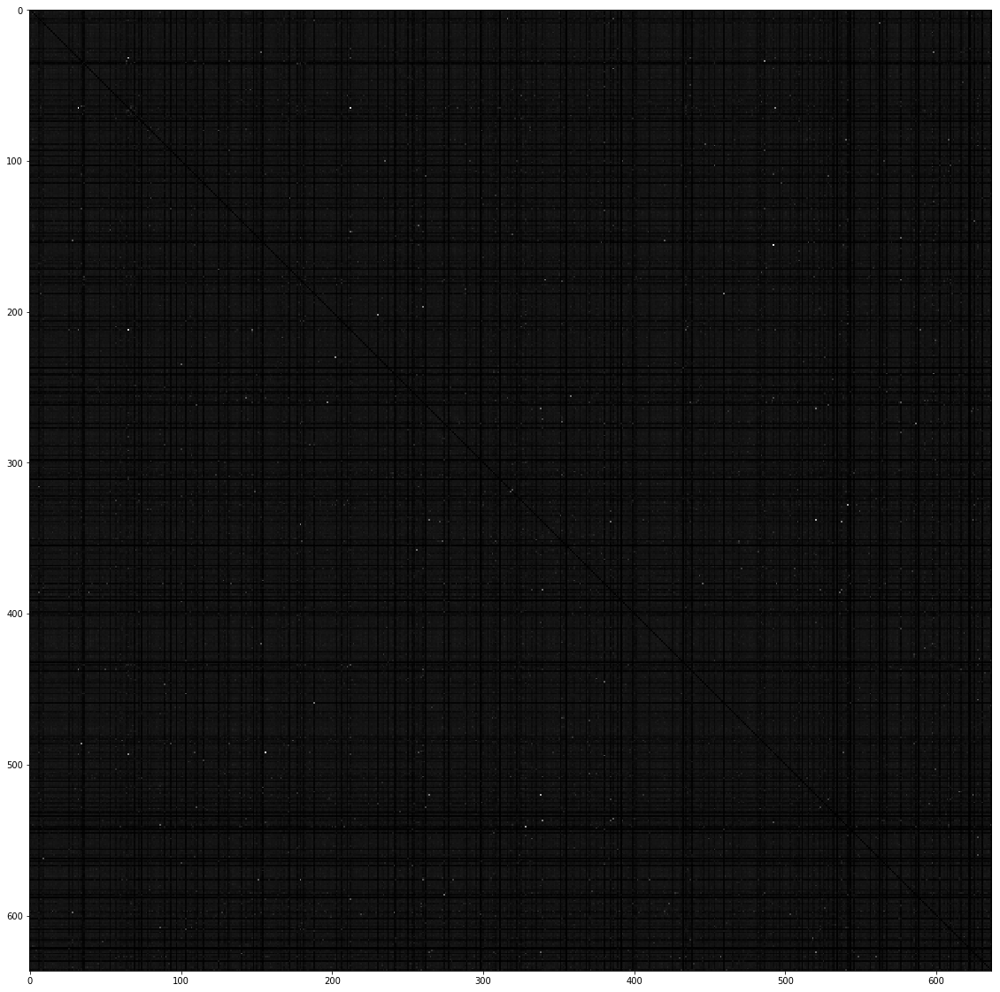

In [145]:
plt.rcParams['figure.figsize'] = (20,20)
plt.imshow(np.power(confusion, 0.8), cmap='gray'); plt.show()

In [162]:
plotly.tools.set_credentials_file(username='ebigelow', api_key='y6y90v7o1e')

In [ ]:
#TODO: list top predictions by GT label
#TODO: top @ k recall

#TODO: bigger picture: 
# - look what happens if we trim down the data a lot (stratified sampling, etc.)
# - maybe trim down more objects -- less than 637 labels